In [1]:
import torch

from detr.data import CocoDataset, get_val_transforms, get_collate_function
from detr.model import DETRConfig, DETR

from safetensors.torch import load_model

from detr.visualize import plot, plot_grid
from detr.utils import PostProcess

from PIL import Image

In [2]:
import matplotlib.pyplot as plt
%matplotlib inline
from IPython.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))

%load_ext autoreload
%autoreload 2

In [3]:
def batch_to_device(batch, device="cpu"):
    for key in batch:
        if isinstance(batch[key], torch.Tensor):
            batch[key] = batch[key].to(device)
        elif isinstance(batch[key], list):
            if isinstance(batch[key][0], torch.Tensor):
                batch[key] = [x.to(device) for x in batch[key]]
    return batch

def flatten_batch(batch, class_names):
    batch_flat = []
    for i in range(batch["image"].shape[0]):
        item = {
            "image": batch["image"][i].detach().cpu(),
            "boxes": batch["boxes"][i].detach().cpu(),
            "class_names": [class_names[c] for c in batch["class_idx"][i].tolist()],
        }
        batch_flat.append(item)
    return batch_flat

In [4]:
val_dataset = CocoDataset(
    dataset_root = "/media/bryan/ssd01/fiftyone/coco-2017",
    split = "validation",
    transform = get_val_transforms()
)
val_dataloader = torch.utils.data.DataLoader(
    val_dataset,
    batch_size=25,
    shuffle=False,
    pin_memory=True,
    drop_last=False,
    num_workers=0,
    collate_fn=get_collate_function(),
)
device = "cuda"

config = DETRConfig(
    num_classes = val_dataset.num_classes
)
model = DETR(config).to(device)
weights_fpath = "/media/bryan/ssd01/expr/detr_from_scratch/100-epochs/checkpoints/checkpoint_99/model.safetensors"
load_model(model, weights_fpath, device = device)

post_process = PostProcess(val_dataset.class_names)

torch.cuda.empty_cache()

loading annotations into memory...
Done (t=0.17s)
creating index...
index created!


In [5]:
batch = next(iter(val_dataloader))
batch = batch_to_device(batch, "cuda")

In [6]:
with torch.inference_mode():
    outputs = model(batch["image"], batch["height"], batch["width"])

batch = batch_to_device(batch, "cpu")
batch_flat = flatten_batch(batch, val_dataset.class_names)


In [19]:
preds = post_process(
    outputs["pred_logits"][:, -1].detach().cpu(),
    outputs["pred_boxes"][:, -1].detach().cpu(),
    batch["height"],
    batch["width"],
    score_threshold=0.75
)
# Add image to predictions
for i, item in enumerate(batch_flat):
    preds[i]["image"] = item["image"]

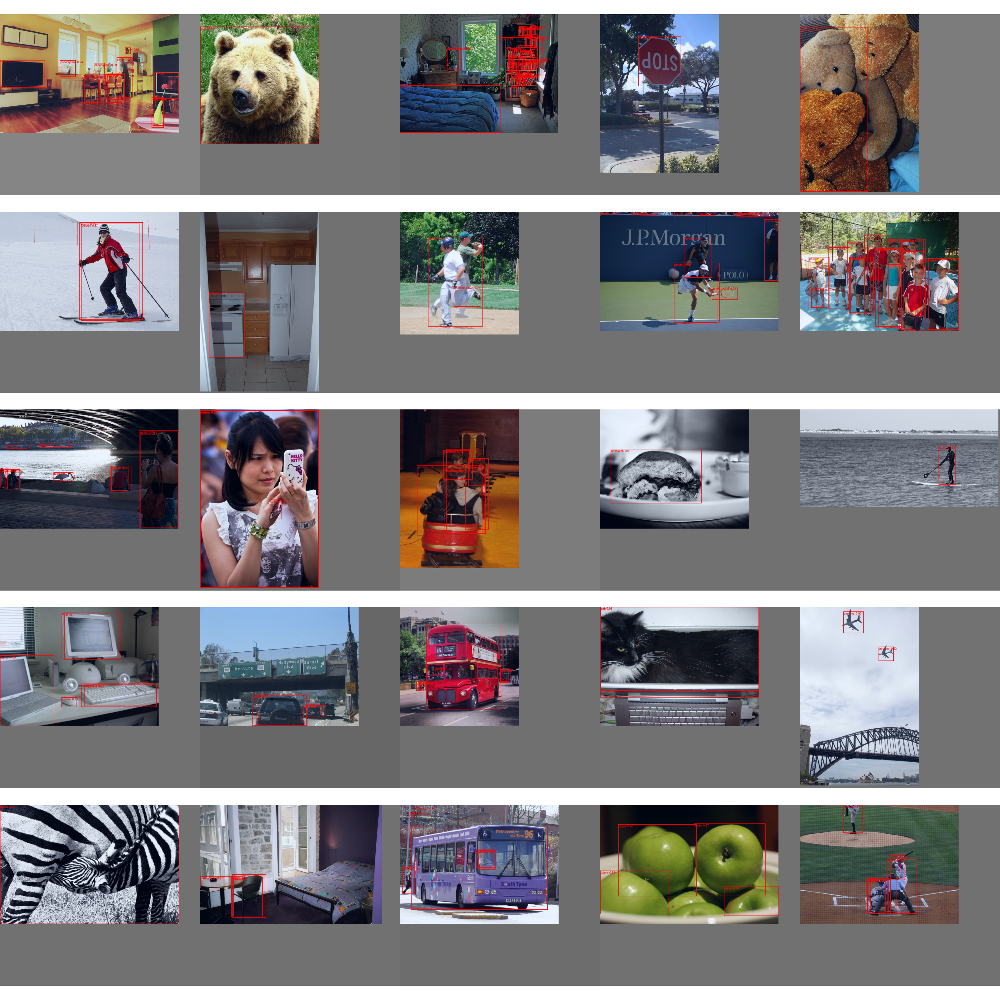

In [20]:
vis = plot_grid(
    preds,
    max_images=25,
    num_cols=5,
    font_size=20,
    box_color="red",
    fig_scaling=7,
)
Image.fromarray(vis)

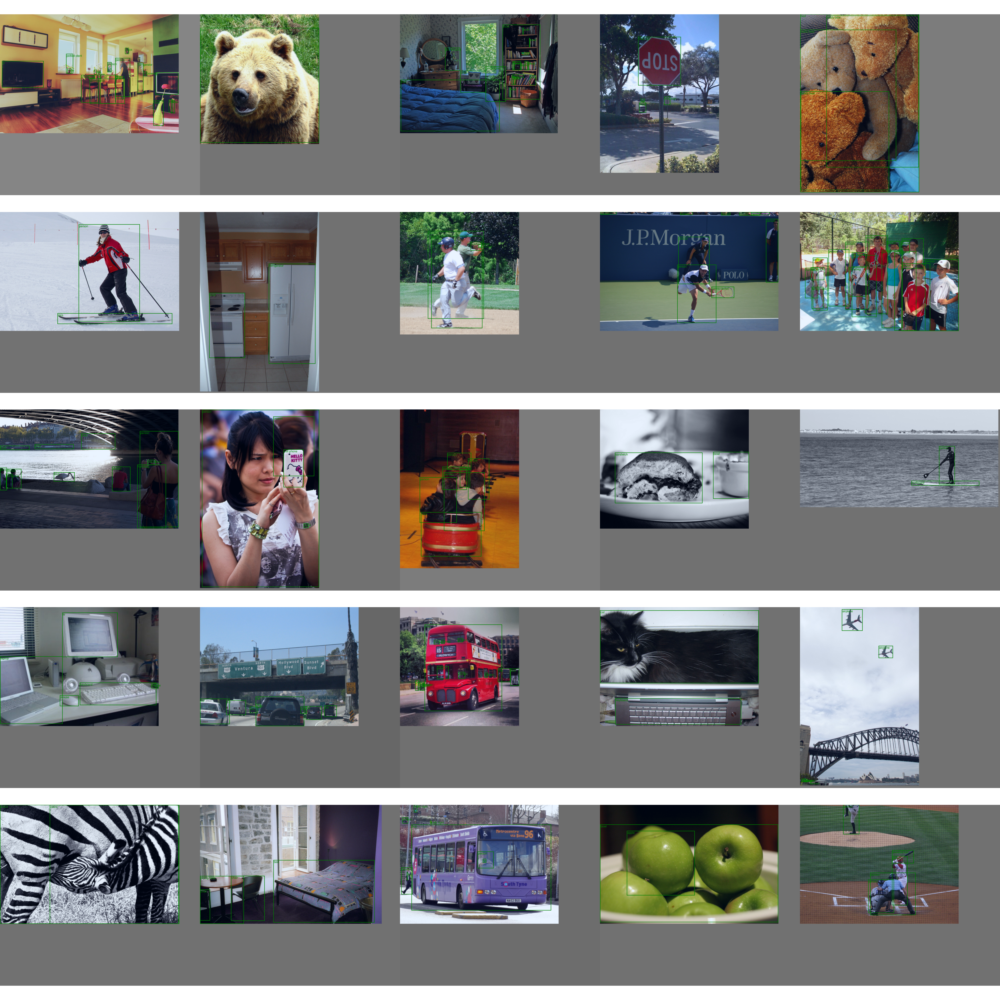

In [21]:
vis = plot_grid(
    batch_flat,
    max_images=25,
    num_cols=5,
    font_size=20,
    box_color="green",
    fig_scaling=7,
)
Image.fromarray(vis)